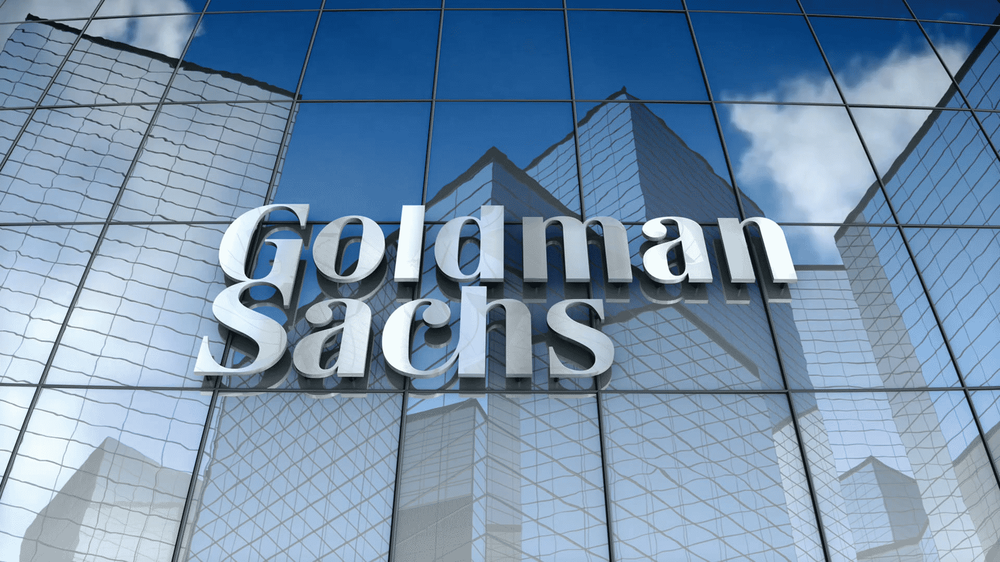

In [1]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt

In [2]:
df = pd.read_csv('jpmorgan_data.csv')
df

,Date,Open,High,Low,Close,Adj Close,Volume
0,03-01-2000,49.833332,50.250000,48.083332,48.583332,24.406227,12019200
1,04-01-2000,47.083332,47.458332,46.125000,47.250000,23.870712,11723400
2,05-01-2000,46.833332,48.375000,46.000000,46.958332,23.723372,8714550
3,06-01-2000,46.750000,48.625000,46.500000,47.625000,24.060173,8369250
4,07-01-2000,48.416668,49.000000,47.333332,48.500000,24.502220,6571950
...,...,...,...,...,...,...,...
5858,17-04-2023,139.949997,140.059998,137.660004,139.830002,139.830002,16050500
5859,18-04-2023,140.270004,141.779999,139.029999,141.399994,141.399994,13760100
5860,19-04-2023,141.229996,141.500000,140.399994,141.220001,141.220001,9158100
5861,20-04-2023,139.910004,141.429993,139.839996,140.809998,140.809998,10586200


In [3]:
df.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,03-01-2000,49.833332,50.250000,48.083332,48.583332,24.406227,12019200
1,04-01-2000,47.083332,47.458332,46.125000,47.250000,23.870712,11723400
2,05-01-2000,46.833332,48.375000,46.000000,46.958332,23.723372,8714550
3,06-01-2000,46.750000,48.625000,46.500000,47.625000,24.060173,8369250
4,07-01-2000,48.416668,49.000000,47.333332,48.500000,24.502220,6571950


In [4]:
df.tail()

,Date,Open,High,Low,Close,Adj Close,Volume
5858,17-04-2023,139.949997,140.059998,137.660004,139.830002,139.830002,16050500
5859,18-04-2023,140.270004,141.779999,139.029999,141.399994,141.399994,13760100
5860,19-04-2023,141.229996,141.500000,140.399994,141.220001,141.220001,9158100
5861,20-04-2023,139.910004,141.429993,139.839996,140.809998,140.809998,10586200
5862,21-04-2023,139.740005,141.110001,138.779999,140.539993,140.539993,11841800


In [5]:
df.columns

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')

In [6]:
df.shape

(5863, 7)

In [7]:
df.isnull().sum()

Date         0
Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

In [8]:
df.describe()

,Open,High,Low,Close,Adj Close,Volume
count,5863.000000,5863.000000,5863.000000,5863.000000,5863.000000,5.863000e+03
mean,64.414728,65.132362,63.682219,64.413200,51.506623,2.032749e+07
std,36.405645,36.676471,36.138749,36.404863,38.360588,1.887252e+07
min,15.370000,16.350000,14.960000,15.450000,8.618587,1.347300e+06
25%,38.660000,39.250000,38.164999,38.715000,24.377334,9.768100e+06
50%,47.880001,48.450001,47.320000,47.820000,31.579823,1.381860e+07
75%,89.834999,90.790001,88.295002,89.465000,76.367790,2.361360e+07
max,172.710007,172.960007,170.539993,171.779999,164.015747,2.172942e+08


In [9]:
df.duplicated().sum()

0

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5863 entries, 0 to 5862
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Date       5863 non-null   object 
 1   Open       5863 non-null   float64
 2   High       5863 non-null   float64
 3   Low        5863 non-null   float64
 4   Close      5863 non-null   float64
 5   Adj Close  5863 non-null   float64
 6   Volume     5863 non-null   int64  
dtypes: float64(5), int64(1), object(1)
memory usage: 320.8+ KB


In [11]:
df = df.drop(columns=['Adj Close'])

In [16]:
import seaborn as sns
import matplotlib.pyplot as plt

In [17]:
import warnings
warnings.filterwarnings('ignore')

In [19]:
import plotly.graph_objects as go

fig = go.Figure(data=go.Scatter(x=df['Date'], y=df['Close'], mode='lines'))

fig.update_layout(
    title='Stock Price',
    xaxis=dict(title='Date'),
    yaxis=dict(title='Close Price'),
)

fig.show()

In [21]:
fig = go.Figure()

# Add the scatter plot
fig.add_trace(go.Scatter(
    x=df['Date'],
    y=df['Close'],
    mode='markers',
    marker=dict(
        size=8,
        color='red'
    ),
    name='Close Prices'
))

fig.update_layout(
    title='Scatter Plot of Close Prices',
    xaxis_title='Date',
    yaxis_title='Close Price',
    showlegend=True,
    plot_bgcolor='black',  # Set the background color to black
    paper_bgcolor='white',  # Set the paper background color to white
    xaxis=dict(showgrid=True, gridcolor='gray'),  # Add gridlines for x-axis
    yaxis=dict(showgrid=True, gridcolor='gray')  # Add gridlines for y-axis
)

fig.show()

In [25]:
# Find the minimum value and its corresponding date
min_close = df['Close'].min()
min_date = df.loc[df['Close'] == min_close, 'Date'].values[0]

# Find the maximum value and its corresponding date
max_close = df['Close'].max()
max_date = df.loc[df['Close'] == max_close, 'Date'].values[0]

print("Minimum Close Value: ", min_close, " Date: ", min_date)
print("Maximum Close Value: ", max_close, " Date: ", max_date)

Minimum Close Value:  15.45  Date:  09-10-2002
Maximum Close Value:  171.779999  Date:  22-10-2021


In [26]:
fig = go.Figure(data=go.Scatter(x=df['Date'], y=df['Volume'], mode='lines'))

fig.update_layout(
    title='Volume Trends',
    xaxis=dict(title='Date'),
    yaxis=dict(title='Volume'),
)

fig.show()

In [27]:
fig = go.Figure()

# Add the scatter plot
fig.add_trace(go.Scatter(
    x=df['Date'],
    y=df['Volume'],
    mode='markers',
    marker=dict(
        size=8,
        color='blue'
    ),
    name='Volume'
))

fig.update_layout(
    title='Scatter Plot of Volume',
    xaxis_title='Date',
    yaxis_title='Volume',
    showlegend=True
)

fig.show()

In [29]:
# Find the minimum value and its corresponding date
min_volume = df['Volume'].min()
min_date = df.loc[df['Volume'] == min_volume, 'Date'].values[0]

# Find the maximum value and its corresponding date
max_volume = df['Volume'].max()
max_date = df.loc[df['Volume'] == max_volume, 'Date'].values[0]

print("Minimum Volume: ", min_volume, " Date: ", min_date)
print("Maximum Volume: ", max_volume, " Date: ", max_date)

Minimum Volume:  1347300  Date:  26-12-2003
Maximum Volume:  217294200  Date:  11-05-2012


In [30]:
df['Market Cap'] = df['Open']*df['Volume']

In [31]:
fig = go.Figure(data=go.Scatter(x=df['Date'], y=df['Market Cap'], mode='lines'))

fig.update_layout(
    title='Market Cap',
    xaxis=dict(title='Date'),
    yaxis=dict(title='Market Cap'),
)

fig.show()

In [32]:
fig = go.Figure()

# Add the scatter plot
fig.add_trace(go.Scatter(
    x=df['Date'],
    y=df['Market Cap'],
    mode='markers',
    marker=dict(
        size=8,
        color='blue'
    ),
    name='Market Cap'
))

fig.update_layout(
    title='Scatter Plot of Market Cap',
    xaxis_title='Date',
    yaxis_title='Market Cap',
    showlegend=True
)

fig.show()

In [33]:
# Assuming df1 is your DataFrame containing the data
minimum_value = df['Market Cap'].min()
maximum_value = df['Market Cap'].max()

# Find the corresponding dates for the minimum and maximum values
minimum_date = df[df['Market Cap'] == minimum_value]['Date'].iloc[0]
maximum_date = df[df['Market Cap'] == maximum_value]['Date'].iloc[0]

print("Minimum Market Cap:", minimum_value, "on", minimum_date)
print("Maximum Market Cap:", maximum_value, "on", maximum_date)

Minimum Market Cap: 48866571.00000001 on 26-12-2003
Maximum Market Cap: 8462667315.906 on 19-03-2021


In [17]:
yearly_data = {}

In [18]:
for year in range(start_date.year,end_date.year + 1):
    start_of_year = pd.Timestamp(year=year, month=1,day=1)
    end_of_year = pd.Timestamp(year=year,month=12,day=31)
    yearly_df = df.loc[(df.index >=start_of_year) & (df.index <=end_of_year)]
    yearly_df = yearly_df.drop('Volume',axis=1)
    yearly_data[year]= yearly_df

TypeError: '>=' not supported between instances of 'numpy.ndarray' and 'Timestamp'

In [19]:
df_2023 = yearly_data[2023]

KeyError: 2023

In [20]:
df_2023

NameError: name 'df_2023' is not defined

In [20]:
import plotly.graph_objects as go
fig = go.Figure()

In [21]:
# Iterate over each year
for year, yearly_df in yearly_data.items():
    # Filter the dataframe based on the specified start and end dates
    filtered_df = yearly_df.loc[(yearly_df.index >= sd) & (yearly_df.index <= ed)]
    
    # Create a figure object for the current year
    fig = go.Figure()
    
    # Add a trace for the 'Open' values
    fig.add_trace(go.Scatter(
        x=filtered_df.index,
        y=filtered_df['Open'],
        mode='lines',
        name='Open'
    ))
    
    # Customize the layout for the current year
    fig.update_layout(
        title=f'Open Values Line Plot for {year}',
        xaxis_title='Date',
        yaxis_title='Open',
        showlegend=True,
    )
    
    # Show the plot for the current year
    fig.show()

In [22]:
# Iterate over each year
for year, yearly_df in yearly_data.items():
    # Filter the dataframe based on the specified start and end dates
    filtered_df = yearly_df.loc[(yearly_df.index >= sd) & (yearly_df.index <= ed)]
    
    # Create a figure object for the current year
    fig = go.Figure()
    
    # Add a trace for the 'Open' values
    fig.add_trace(go.Scatter(
        x=filtered_df.index,
        y=filtered_df['Open'],
        mode='markers',
        name='Open'
    ))
    
    # Customize the layout for the current year
    fig.update_layout(
        title=f'Open Values Scatter Plot for {year}',
        xaxis_title='Date',
        yaxis_title='Open',
        showlegend=True,
    )
    
    # Show the plot for the current year
    fig.show()

In [23]:
# Iterate over each year
for year, yearly_df in yearly_data.items():
    # Filter the dataframe based on the specified start and end dates
    filtered_df = yearly_df.loc[(yearly_df.index >= sd) & (yearly_df.index <= ed)]
    
    # Create a figure object for the current year
    fig = go.Figure()
    
    # Add a trace for the 'Open' values
    fig.add_trace(go.Scatter(
        x=filtered_df.index,
        y=filtered_df['Close'],
        mode='lines',
        name='Close'
    ))
    
    # Customize the layout for the current year
    fig.update_layout(
        title=f'Close Values Line Plot for {year}',
        xaxis_title='Date',
        yaxis_title='Close',
        showlegend=True,
    )
    
    # Show the plot for the current year
    fig.show()

In [24]:
#Iterate over each year
for year, yearly_df in yearly_data.items():
    # Filter the dataframe based on the specified start and end dates
    filtered_df = yearly_df.loc[(yearly_df.index >= sd) & (yearly_df.index <= ed)]
    
    # Create a figure object for the current year
    fig = go.Figure()
    
    # Add a trace for the 'Open' values
    fig.add_trace(go.Scatter(
        x=filtered_df.index,
        y=filtered_df['Close'],
        mode='markers',
        name='Close'
    ))
    
    # Customize the layout for the current year
    fig.update_layout(
        title=f'Close Values Line Plot for {year}',
        xaxis_title='Date',
        yaxis_title='Close',
        showlegend=True,
    )
    
    # Show the plot for the current year
    fig.show()

In [25]:
# Iterate over each year
for year, yearly_df in yearly_data.items():
    # Filter the dataframe based on the specified start and end dates
    filtered_df = yearly_df.loc[(yearly_df.index >= sd) & (yearly_df.index <= ed)]
    
    # Create a figure object for the current year
    fig = go.Figure()
    
    # Add a trace for the 'Open' values
    fig.add_trace(go.Scatter(
        x=filtered_df.index,
        y=filtered_df['Open'],
        mode='lines',
        name='Open'
    ))
    
    # Add a trace for the 'Close' values
    fig.add_trace(go.Scatter(
        x=filtered_df.index,
        y=filtered_df['Close'],
        mode='lines',
        name='Close'
    ))
    
    # Customize the layout for the current year
    fig.update_layout(
        title=f'Open vs Close Values for {year}',
        xaxis_title='Date',
        yaxis_title='Price',
        showlegend=True,
    )
    
    # Show the plot for the current year
    fig.show()

In [26]:
# Iterate over each year
for year, yearly_df in yearly_data.items():
    # Filter the dataframe based on the specified start and end dates
    filtered_df = yearly_df.loc[(yearly_df.index >= sd) & (yearly_df.index <= ed)]
    
    # Create a figure object for the current year
    fig = go.Figure()
    
    # Add a trace for the 'Open' values
    fig.add_trace(go.Scatter(
        x=filtered_df.index,
        y=filtered_df['Open'],
        mode='markers',
        name='Open'
    ))
    
    # Add a trace for the 'Close' values
    fig.add_trace(go.Scatter(
        x=filtered_df.index,
        y=filtered_df['Close'],
        mode='markers',
        name='Close'
    ))
    
    # Customize the layout for the current year
    fig.update_layout(
        title=f'Scatter Plot: Open vs Close Values for {year}',
        xaxis_title='Date',
        yaxis_title='Price',
        showlegend=True,
    )
    
    # Show the plot for the current year
    fig.show()

In [27]:
import plotly.express as px

# Iterate over each year
for year, yearly_df in yearly_data.items():
    # Filter the data based on the starting and ending dates
    yearly_df = yearly_df.loc[(yearly_df.index >= start_date) & (yearly_df.index <= end_date)]
    
    # Reset the index and add 'Date' column
    yearly_df = yearly_df.reset_index()
    yearly_df['Date'] = yearly_df['Date'].dt.strftime('%B')
    
    # Calculate the mean of 'Open' values for each month
    monthly_mean = yearly_df.groupby('Date')['Open'].mean().reset_index()
    
    # Create a line plot for the mean 'Open' values for the current year
    fig = px.line(monthly_mean, x='Date', y='Open', title=f'Mean Open Values for Year {year} ({start_date.year} to {end_date.year})')
    fig.show()

In [28]:
import plotly.express as px

# Iterate over each year
for year, yearly_df in yearly_data.items():
    # Filter the data based on the starting and ending dates
    yearly_df = yearly_df.loc[(yearly_df.index >= start_date) & (yearly_df.index <= end_date)]
    
    # Reset the index and add 'Date' column
    yearly_df = yearly_df.reset_index()
    yearly_df['Date'] = yearly_df['Date'].dt.strftime('%B')
    
    # Calculate the mean of 'Open' values for each month
    monthly_mean = yearly_df.groupby('Date')['Open'].mean().reset_index()
    
    # Create a scatter plot for the mean 'Open' values for the current year
    fig = px.scatter(monthly_mean, x='Date', y='Open', title=f'Mean Open Values for Year {year} ({start_date.year} to {end_date.year})')
    fig.show()

In [29]:
import plotly.express as px

# Iterate over each year
for year, yearly_df in yearly_data.items():
    # Filter the data based on the starting and ending dates
    yearly_df = yearly_df.loc[(yearly_df.index >= start_date) & (yearly_df.index <= end_date)]
    
    # Reset the index and add 'Date' column
    yearly_df = yearly_df.reset_index()
    yearly_df['Date'] = yearly_df['Date'].dt.strftime('%B')
    
    # Calculate the mean of 'Close' values for each month
    monthly_mean = yearly_df.groupby('Date')['Close'].mean().reset_index()
    
    # Create a line plot for the mean 'Close' values for the current year
    fig = px.line(monthly_mean, x='Date', y='Close', title=f'Mean Close Values for Year {year} ({start_date.year} to {end_date.year})')
    fig.show()

In [30]:
import plotly.express as px

# Iterate over each year
for year, yearly_df in yearly_data.items():
    # Filter the data based on the starting and ending dates
    yearly_df = yearly_df.loc[(yearly_df.index >= start_date) & (yearly_df.index <= end_date)]
    
    # Reset the index and add 'Date' column
    yearly_df = yearly_df.reset_index()
    yearly_df['Date'] = yearly_df['Date'].dt.strftime('%B')
    
    # Calculate the mean of 'Close' values for each month
    monthly_mean = yearly_df.groupby('Date')['Close'].mean().reset_index()
    
    # Create a scatter plot for the mean 'Close' values for the current year
    fig = px.scatter(monthly_mean, x='Date', y='Close', title=f'Mean Close Values for Year {year} ({start_date.year} to {end_date.year})')
    fig.show()